In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
### Initial imports
import logging
import numpy as np
import pandas as pd
import pymc3 as pm
import theano.tensor as T
import matplotlib.pyplot as plt
import seaborn as sns
sns.set_style("ticks")

logging.basicConfig(level=logging.INFO)
log = logging.getLogger(__name__)

import warnings
warnings.simplefilter(action="ignore", category=FutureWarning)

from epimodel.pymc3_models import cm_effect
from epimodel.pymc3_models.cm_effect.datapreprocessor import DataPreprocessor

%matplotlib inline

INFO:epimodel.pymc3_models.cm_effect.datapreprocessor:Performing Smoothing
INFO:epimodel.pymc3_models.cm_effect.datapreprocessor:Skipping smoothing Albania
INFO:epimodel.pymc3_models.cm_effect.datapreprocessor:Skipping smoothing Andorra
INFO:epimodel.pymc3_models.cm_effect.datapreprocessor:Skipping smoothing Estonia
INFO:epimodel.pymc3_models.cm_effect.datapreprocessor:Skipping smoothing Iceland
INFO:epimodel.pymc3_models.cm_effect.datapreprocessor:Skipping smoothing Latvia
INFO:epimodel.pymc3_models.cm_effect.datapreprocessor:Skipping smoothing Lithuania
INFO:epimodel.pymc3_models.cm_effect.datapreprocessor:Skipping smoothing New Zealand
INFO:epimodel.pymc3_models.cm_effect.datapreprocessor:Skipping smoothing Singapore
INFO:epimodel.pymc3_models.cm_effect.datapreprocessor:Skipping smoothing Slovakia
INFO:epimodel.pymc3_models.cm_effect.datapreprocessor:Performing Masking


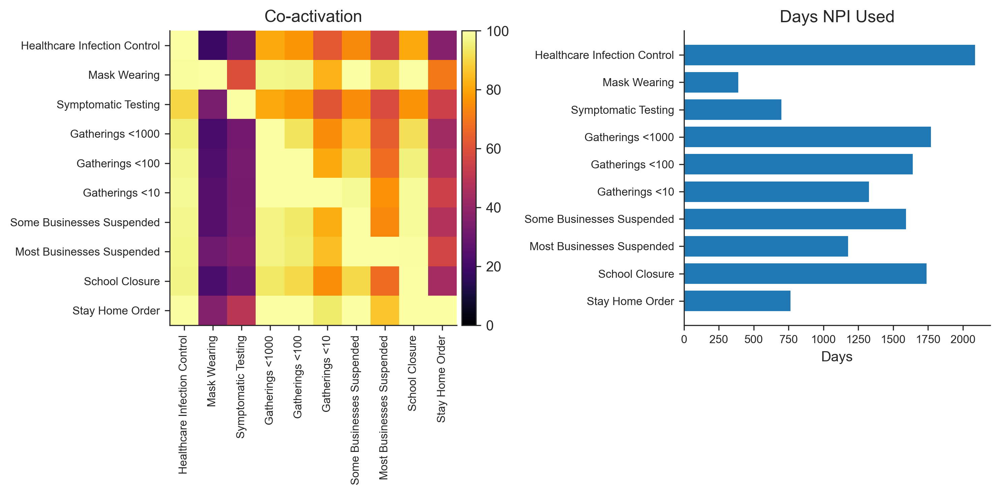

In [3]:
dp = DataPreprocessor()
data = dp.preprocess_data("data_final.csv")

In [4]:
# def mask_region_ends(d, region, ndays=10):
#     i = d.Rs.index(region)
#     d.Active.mask[i,-ndays:] = True
#     d.Confirmed.mask[i,-ndays:] = True
#     d.Deaths.mask[i,-ndays:] = True
#     d.NewDeaths.mask[i,-ndays:] = True
#     d.NewCases.mask[i,-ndays:] = True

# for region in data.Rs:
#     mask_region_ends(data, region, 7)
    
# mask_region_ends(data, "ES", 40)
# mask_region_ends(data, "FR", 40)

In [5]:
data.CMs

['Healthcare Infection Control',
 'Mask Wearing',
 'Symptomatic Testing',
 'Gatherings <1000',
 'Gatherings <100',
 'Gatherings <10',
 'Some Businesses Suspended',
 'Most Businesses Suspended',
 'School Closure',
 'Stay Home Order']

In [66]:
with cm_effect.models.CMCombined_Final(data) as model:
    model.build_model()

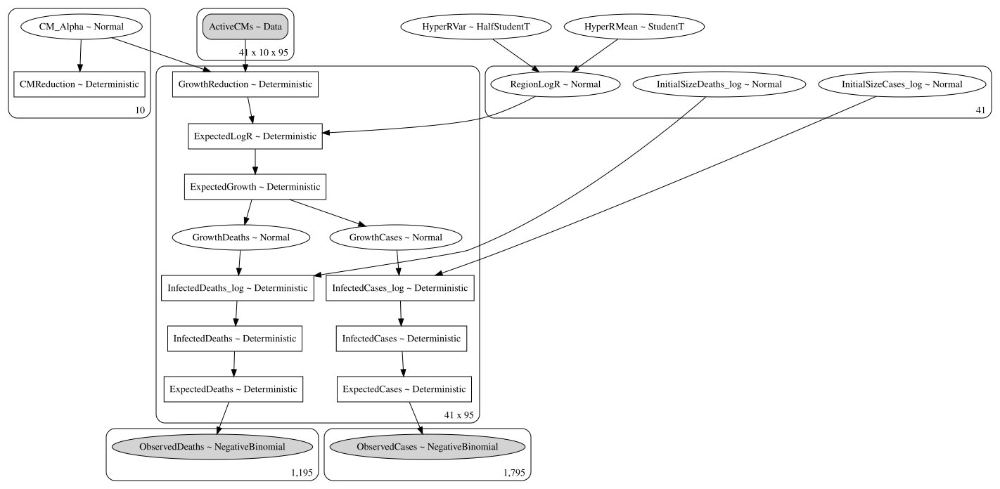

In [10]:
pm.model_to_graphviz(model).render("model-combined-final")
pm.model_to_graphviz(model)

In [67]:
with model.model:
    model.trace = pm.sample(2000, chains=2, start=start, )

Auto-assigning NUTS sampler...
INFO:pymc3:Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
INFO:pymc3:Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (2 chains in 4 jobs)
INFO:pymc3:Multiprocess sampling (2 chains in 4 jobs)
NUTS: [InitialSizeDeaths_log, InitialSizeCases_log, GrowthDeaths, GrowthCases, RegionLogROffset, HyperRVar, HyperRMean, CM_Alpha]
INFO:pymc3:NUTS: [InitialSizeDeaths_log, InitialSizeCases_log, GrowthDeaths, GrowthCases, RegionLogROffset, HyperRVar, HyperRMean, CM_Alpha]
Sampling 2 chains, 0 divergences: 100%|██████████| 5000/5000 [40:10<00:00,  2.07draws/s]
The number of effective samples is smaller than 10% for some parameters.


In [10]:
start = model.trace.point(-1)

In [11]:
with model.model:
    model.trace = pm.sample(2000, chains=2, start=start)

Auto-assigning NUTS sampler...
INFO:pymc3:Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
INFO:pymc3:Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (2 chains in 4 jobs)
INFO:pymc3:Multiprocess sampling (2 chains in 4 jobs)
NUTS: [InitialSizeDeaths_log, InitialSizeCases_log, GrowthDeaths, GrowthCases, RegionLogR, HyperRVar, HyperRMean, CM_Alpha]
INFO:pymc3:NUTS: [InitialSizeDeaths_log, InitialSizeCases_log, GrowthDeaths, GrowthCases, RegionLogR, HyperRVar, HyperRMean, CM_Alpha]
Sampling 2 chains, 0 divergences:  61%|██████    | 3058/5000 [24:06<15:18,  2.11draws/s]
The estimated number of effective samples is smaller than 200 for some parameters.
ERROR:pymc3:The estimated number of effective samples is smaller than 200 for some parameters.


In [12]:
np.savetxt("comb1005.txt", model.trace["CMReduction"])

INFO:epimodel.pymc3_models.cm_effect.models:Saving Plot at /Users/jsalvatier/workspace/cov19/epimodel/notebooks/final_data/out at 10-05;20-35
INFO:epimodel.pymc3_models.cm_effect.models:Saving Plot at /Users/jsalvatier/workspace/cov19/epimodel/notebooks/final_data/out at 10-05;20-35


<Figure size 2100x900 with 0 Axes>

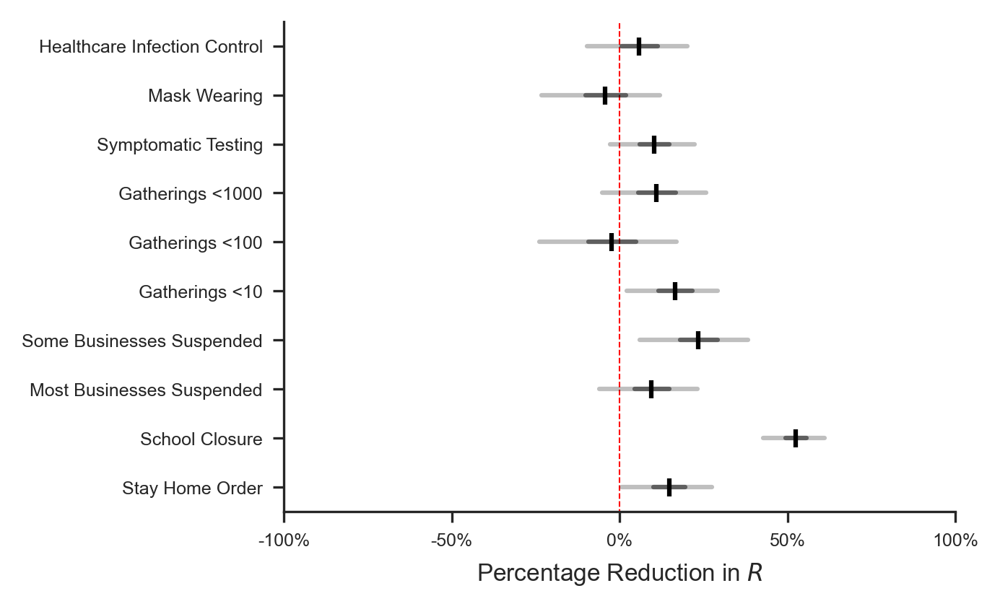

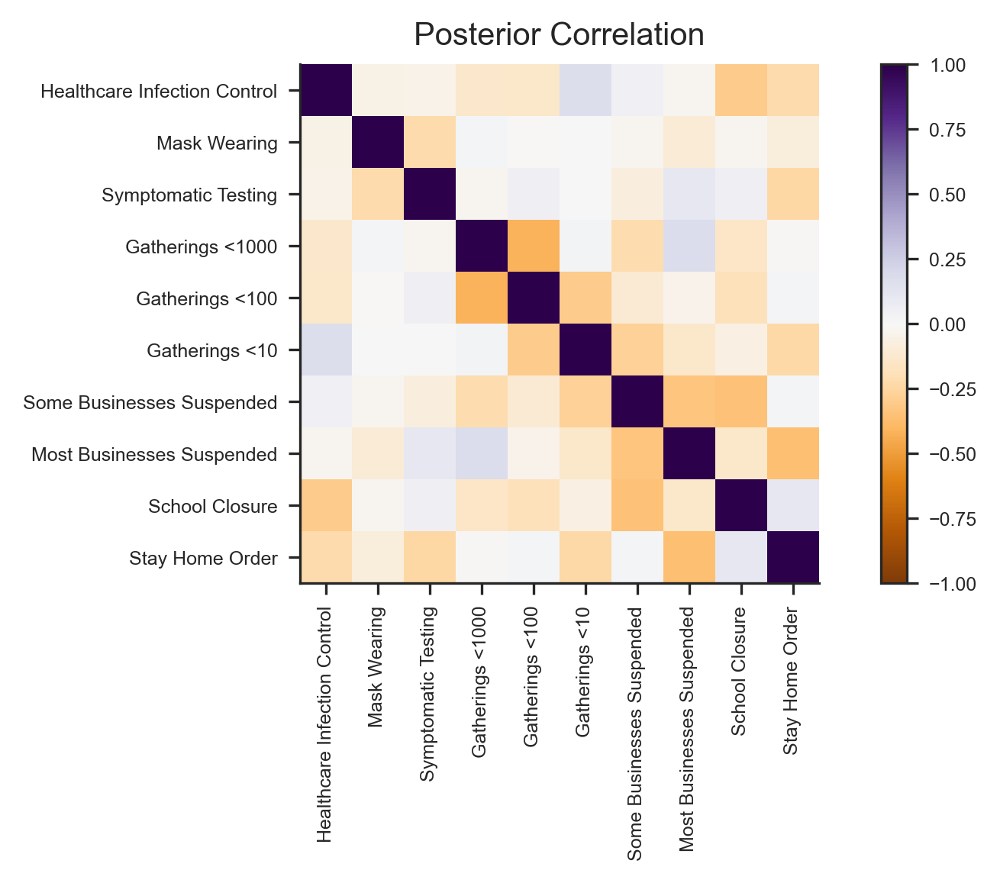

In [60]:
model.plot_effect()

In [8]:
cm_plot_style = [
            ("\uf7f2", "tab:red"), # hospital symbol
            ("\uf963", "black"), # mask
            ("\uf492", "mediumblue"), # vial
            ("\uf0c0", "lightgrey"), # ppl
            ("\uf0c0", "grey"), # ppl
            ("\uf0c0", "black"), # ppl
            ("\uf07a", "tab:orange"), # shop 1
            ("\uf07a", "tab:red"), # shop2 
            ("\uf19d", "black"), # school
            ("\uf965", "black") # home
        ]
model.plot_subset_region_predictions([2, 11, 19, 37, 40], cm_plot_style)

/Users/jsalvatier/workspace/cov19/epimodel/epimodel/pymc3_models/cm_effect/models.py:1592: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all axes decorations. 
  plt.tight_layout()
INFO:epimodel.pymc3_models.cm_effect.models:Saving Plot at /Users/jsalvatier/workspace/cov19/epimodel/notebooks/final_data/out at 10-05;16-10
/Users/jsalvatier/workspace/cov19/epimodel/epimodel/pymc3_models/cm_effect/models.py:1592: UserWarning: Tight layout not applied. The bottom and top margins cannot be made large enough to accommodate all axes decorations. 
  plt.tight_layout()
INFO:epimodel.pymc3_models.cm_effect.models:Saving Plot at /Users/jsalvatier/workspace/cov19/epimodel/notebooks/final_data/out at 10-05;16-10


ValueError: Image size of 2013x246988678 pixels is too large. It must be less than 2^16 in each direction.

<Figure size 2400x6000 with 20 Axes>

In [28]:
model.d.Rs.index("AT")

2

INFO:epimodel.pymc3_models.cm_effect.models:Saving Plot at /Users/jsalvatier/workspace/cov19/epimodel/notebooks/final_data/out at 10-05;22-56
INFO:epimodel.pymc3_models.cm_effect.models:Saving Plot at /Users/jsalvatier/workspace/cov19/epimodel/notebooks/final_data/out at 10-05;22-56


GE


INFO:epimodel.pymc3_models.cm_effect.models:Saving Plot at /Users/jsalvatier/workspace/cov19/epimodel/notebooks/final_data/out at 10-05;22-56
INFO:epimodel.pymc3_models.cm_effect.models:Saving Plot at /Users/jsalvatier/workspace/cov19/epimodel/notebooks/final_data/out at 10-05;22-57


MT


INFO:epimodel.pymc3_models.cm_effect.models:Saving Plot at /Users/jsalvatier/workspace/cov19/epimodel/notebooks/final_data/out at 10-05;22-57
INFO:epimodel.pymc3_models.cm_effect.models:Saving Plot at /Users/jsalvatier/workspace/cov19/epimodel/notebooks/final_data/out at 10-05;22-57
INFO:epimodel.pymc3_models.cm_effect.models:Saving Plot at /Users/jsalvatier/workspace/cov19/epimodel/notebooks/final_data/out at 10-05;22-57
INFO:epimodel.pymc3_models.cm_effect.models:Saving Plot at /Users/jsalvatier/workspace/cov19/epimodel/notebooks/final_data/out at 10-05;22-57
INFO:epimodel.pymc3_models.cm_effect.models:Saving Plot at /Users/jsalvatier/workspace/cov19/epimodel/notebooks/final_data/out at 10-05;22-57


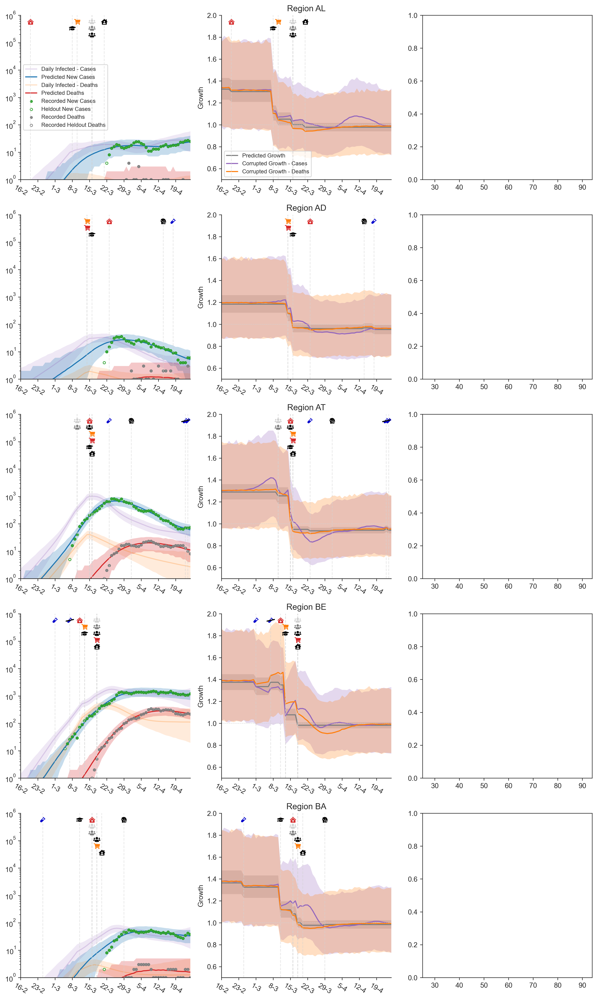

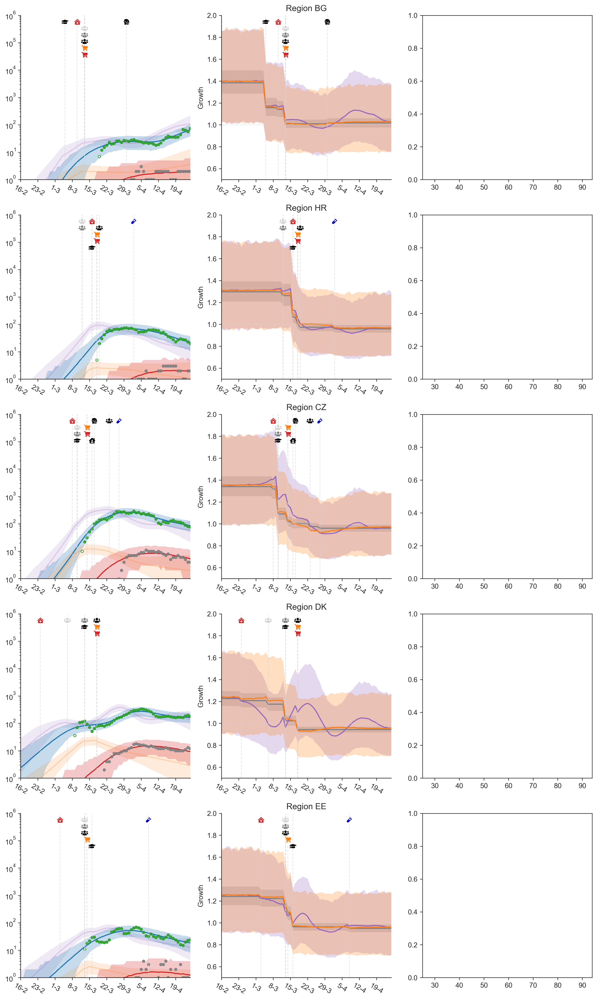

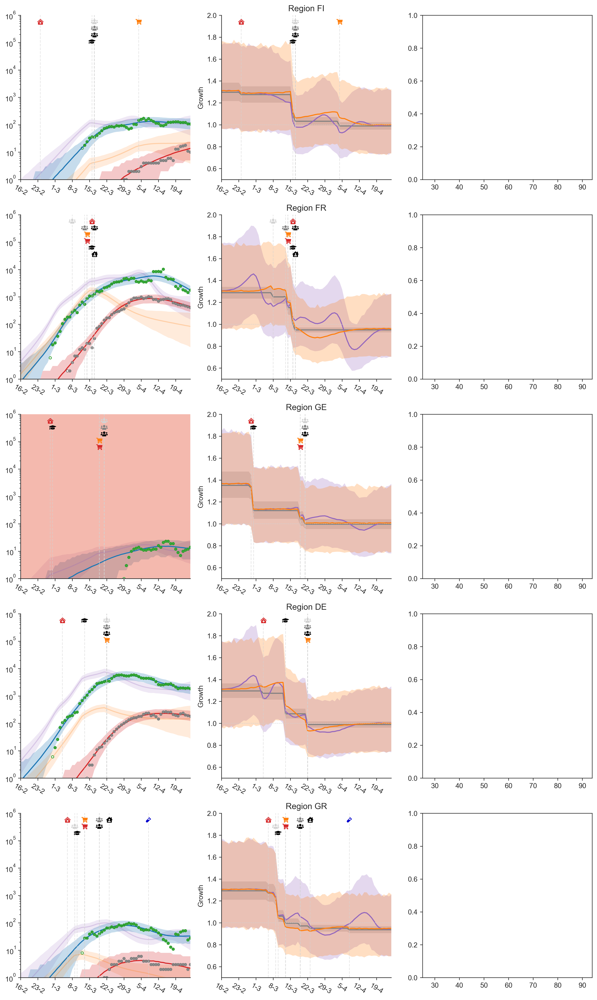

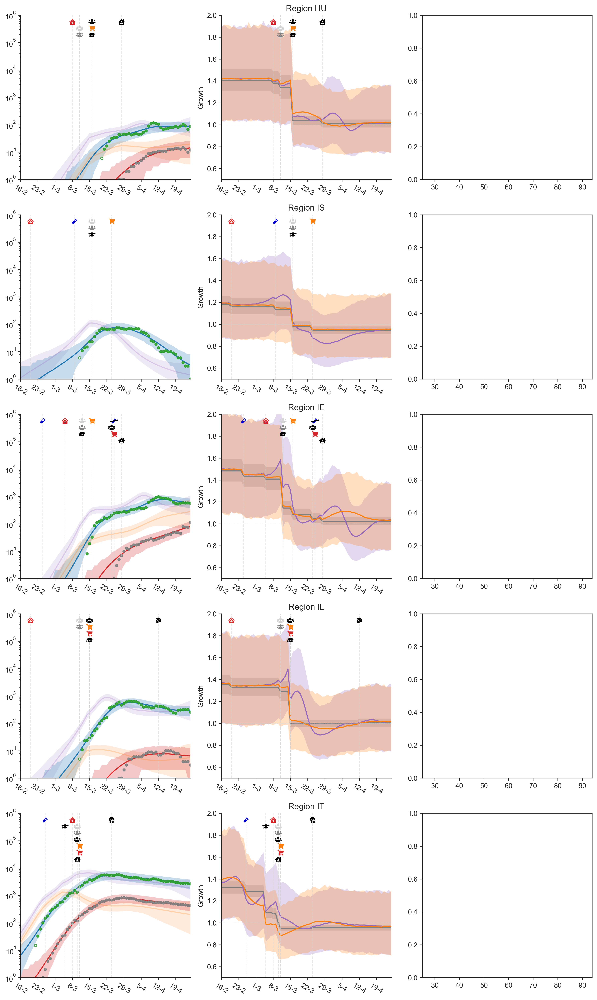

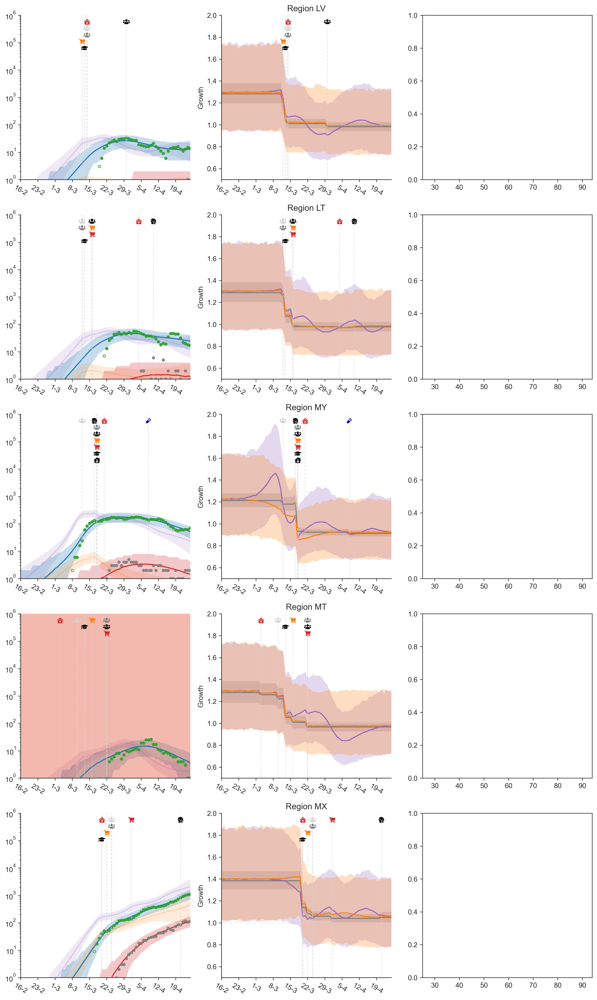

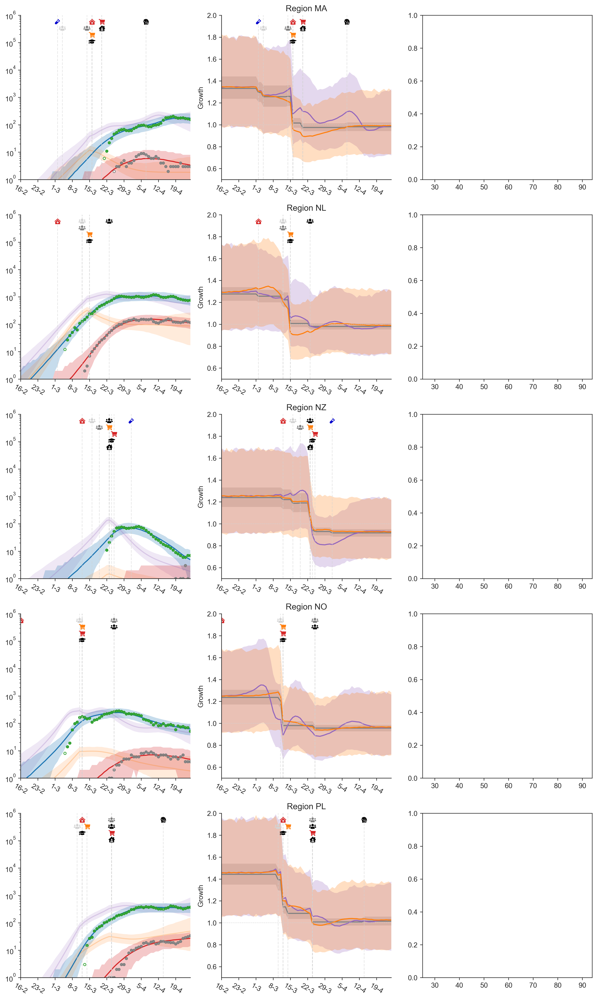

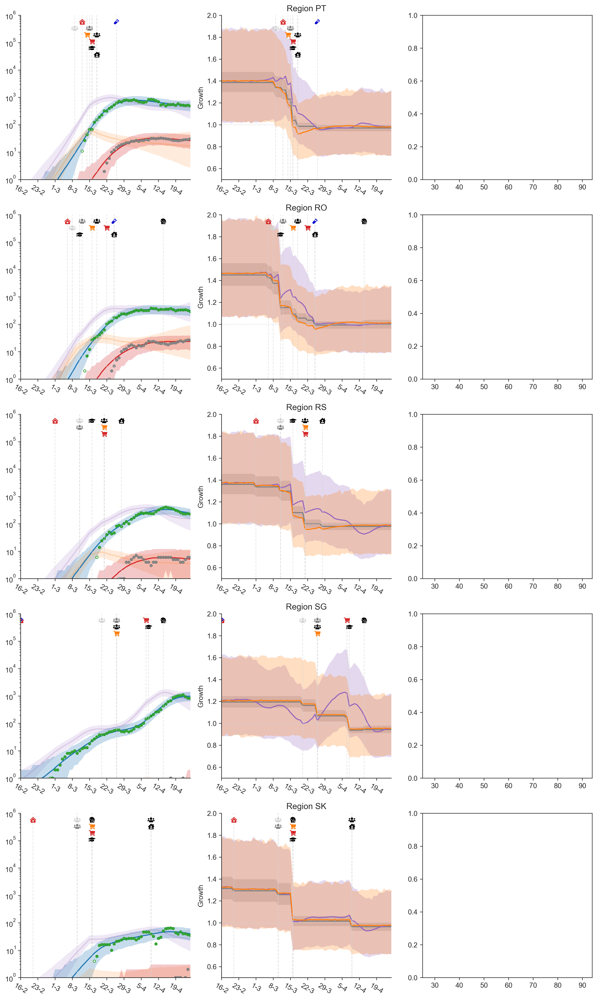

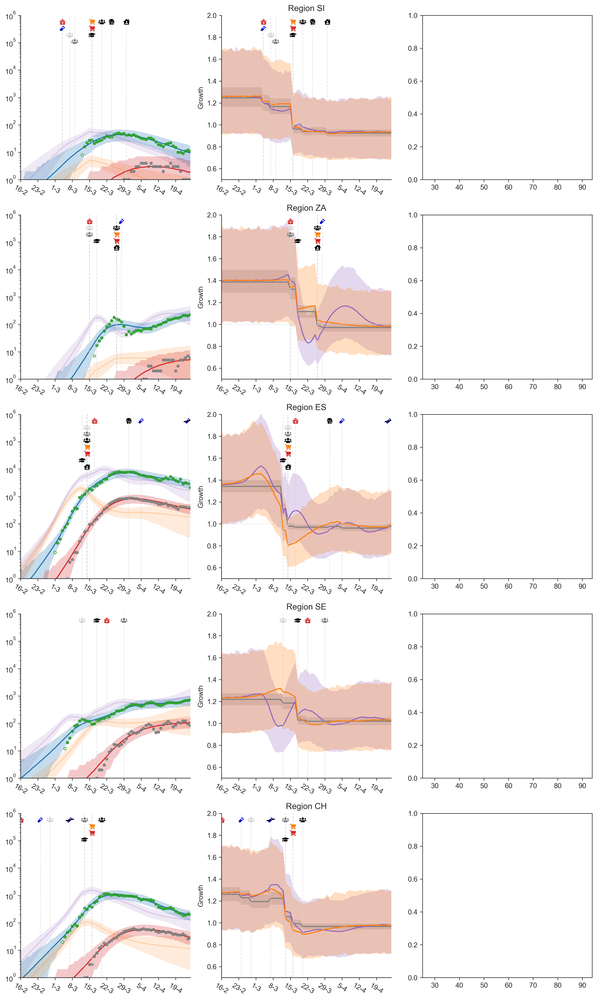

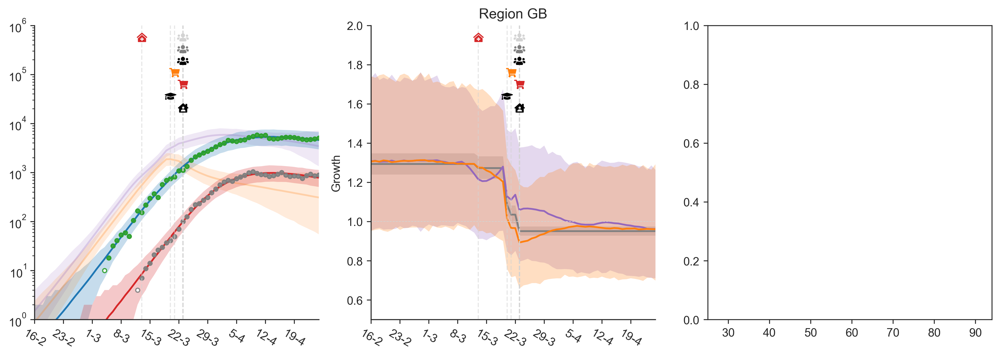

In [68]:
cm_plot_style = [
            ("\uf7f2", "tab:red"), # hospital symbol
            ("\uf963", "black"), # mask
            ("\uf492", "mediumblue"), # vial
            ("\uf0c0", "lightgrey"), # ppl
            ("\uf0c0", "grey"), # ppl
            ("\uf0c0", "black"), # ppl
            ("\uf07a", "tab:orange"), # shop 1
            ("\uf07a", "tab:red"), # shop2 
            ("\uf19d", "black"), # school
            ("\uf965", "black") # home
        ]
model.plot_region_predictions(cm_plot_style)

In [72]:
with cm_effect.models.CMCombined_Final(data) as model2:
    model2.build_model()

In [73]:
start2=model.trace.point(-1)

In [74]:
with model2.model:
    model2.trace = pm.sample(2000, chains=2, start=start2)

Auto-assigning NUTS sampler...
INFO:pymc3:Auto-assigning NUTS sampler...
Initializing NUTS using jitter+adapt_diag...
INFO:pymc3:Initializing NUTS using jitter+adapt_diag...
Multiprocess sampling (2 chains in 4 jobs)
INFO:pymc3:Multiprocess sampling (2 chains in 4 jobs)
NUTS: [InitialSizeDeaths_log, InitialSizeCases_log, GrowthCases, RegionLogROffset, HyperRVar, HyperRMean, CM_Alpha]
INFO:pymc3:NUTS: [InitialSizeDeaths_log, InitialSizeCases_log, GrowthCases, RegionLogROffset, HyperRVar, HyperRMean, CM_Alpha]
Sampling 2 chains, 0 divergences: 100%|██████████| 5000/5000 [32:04<00:00,  2.60draws/s]
The number of effective samples is smaller than 10% for some parameters.


INFO:epimodel.pymc3_models.cm_effect.models:Saving Plot at /Users/mrinank/workspace/epidemicforecasting/epimodel/notebooks/final_data/out at 10-05;11-44
INFO:epimodel.pymc3_models.cm_effect.models:Saving Plot at /Users/mrinank/workspace/epidemicforecasting/epimodel/notebooks/final_data/out at 10-05;11-44


<Figure size 2100x900 with 0 Axes>

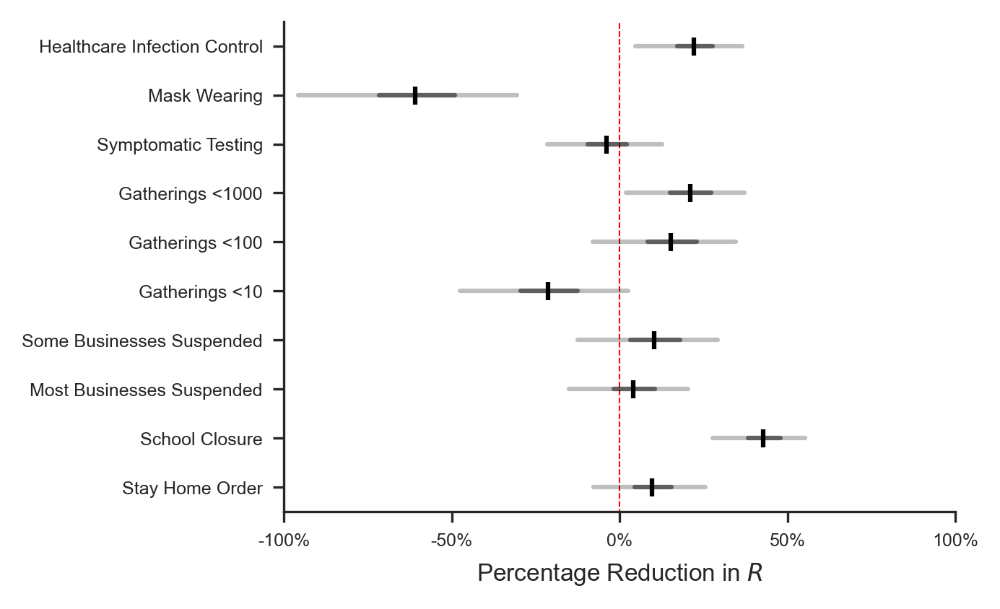

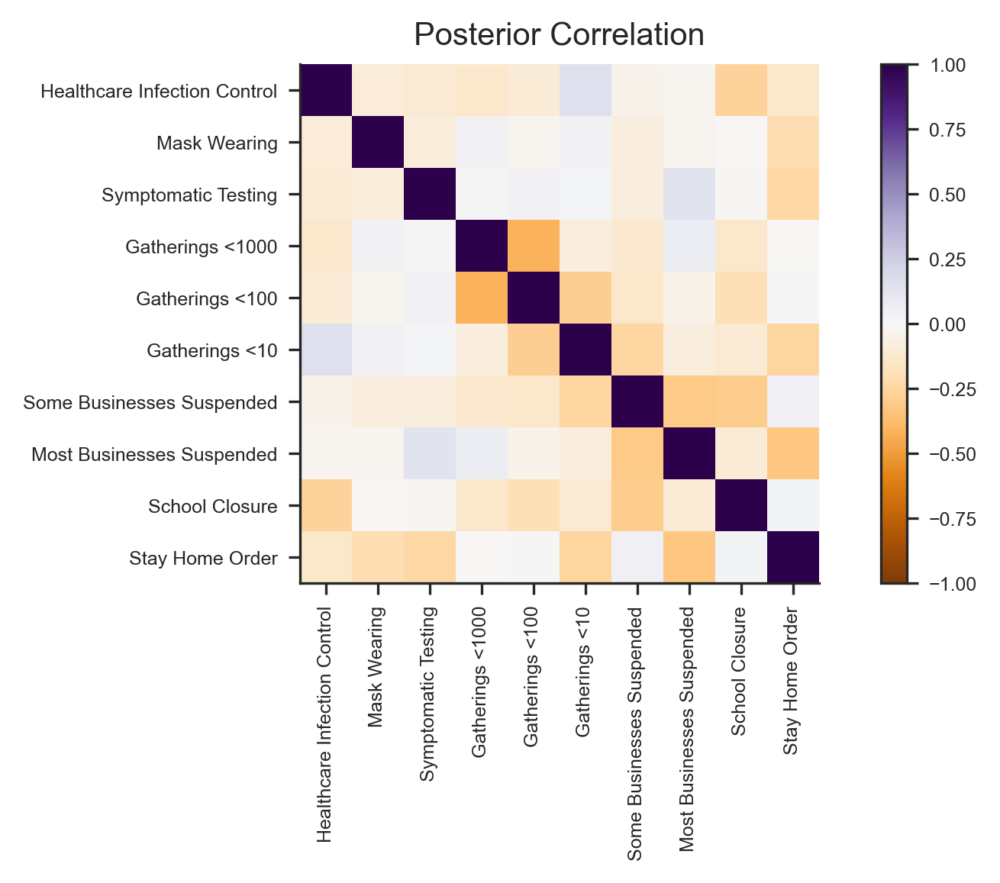

In [8]:
model2.plot_effect()

In [10]:
np.mean(model2.trace.Phi_1)

0.12481955647039035

In [89]:
np.mean(model.trace.Phi)

0.3747976346534668

INFO:epimodel.pymc3_models.cm_effect.models:Saving Plot at /Users/jsalvatier/workspace/cov19/epimodel/notebooks/final_data/out at 10-05;22-58
INFO:epimodel.pymc3_models.cm_effect.models:Saving Plot at /Users/jsalvatier/workspace/cov19/epimodel/notebooks/final_data/out at 10-05;22-58


GE


INFO:epimodel.pymc3_models.cm_effect.models:Saving Plot at /Users/jsalvatier/workspace/cov19/epimodel/notebooks/final_data/out at 10-05;22-59
INFO:epimodel.pymc3_models.cm_effect.models:Saving Plot at /Users/jsalvatier/workspace/cov19/epimodel/notebooks/final_data/out at 10-05;22-59


MT


INFO:epimodel.pymc3_models.cm_effect.models:Saving Plot at /Users/jsalvatier/workspace/cov19/epimodel/notebooks/final_data/out at 10-05;22-59
INFO:epimodel.pymc3_models.cm_effect.models:Saving Plot at /Users/jsalvatier/workspace/cov19/epimodel/notebooks/final_data/out at 10-05;22-59
INFO:epimodel.pymc3_models.cm_effect.models:Saving Plot at /Users/jsalvatier/workspace/cov19/epimodel/notebooks/final_data/out at 10-05;22-59
INFO:epimodel.pymc3_models.cm_effect.models:Saving Plot at /Users/jsalvatier/workspace/cov19/epimodel/notebooks/final_data/out at 10-05;22-59
INFO:epimodel.pymc3_models.cm_effect.models:Saving Plot at /Users/jsalvatier/workspace/cov19/epimodel/notebooks/final_data/out at 10-05;22-59


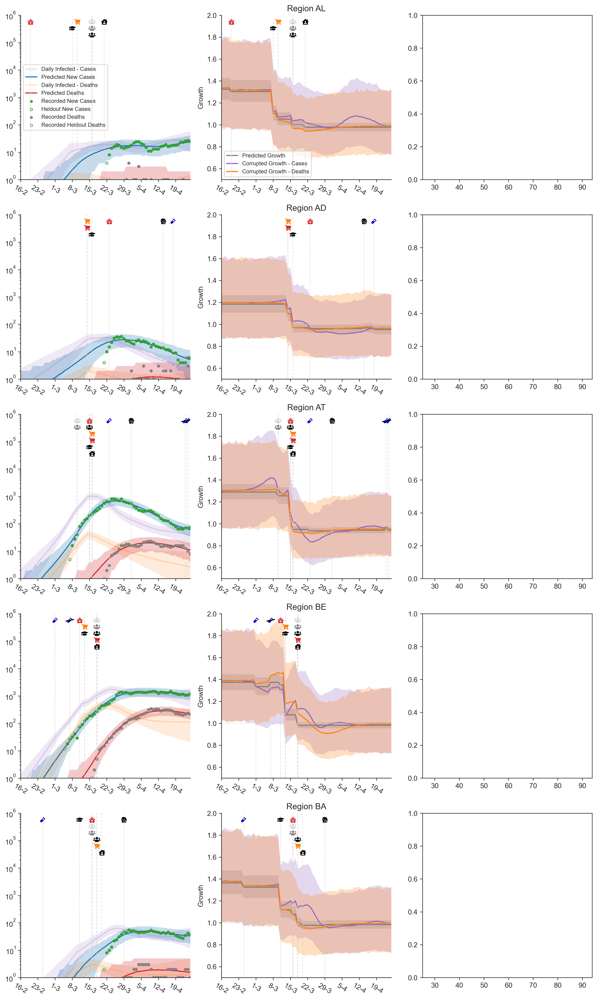

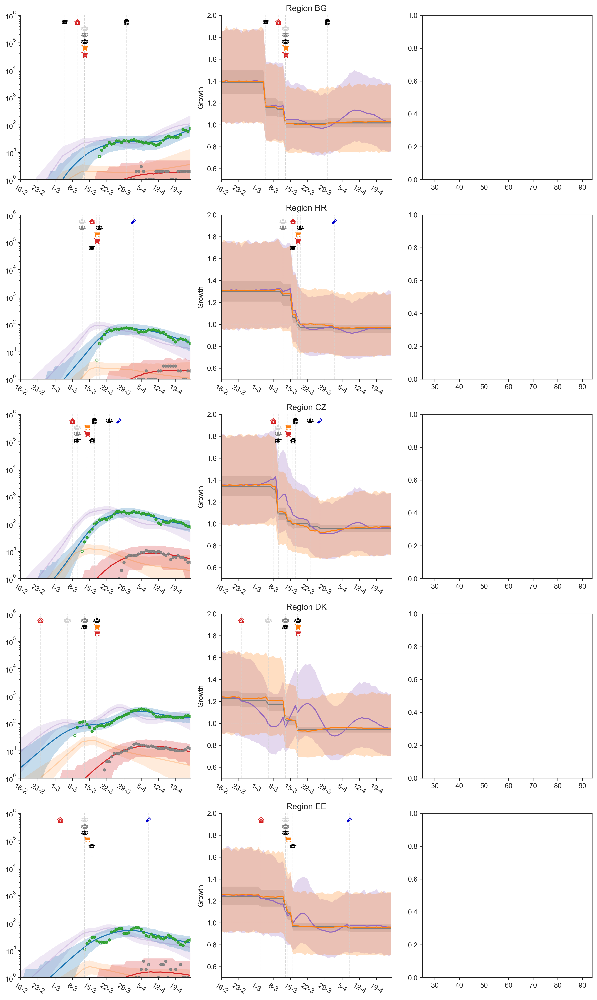

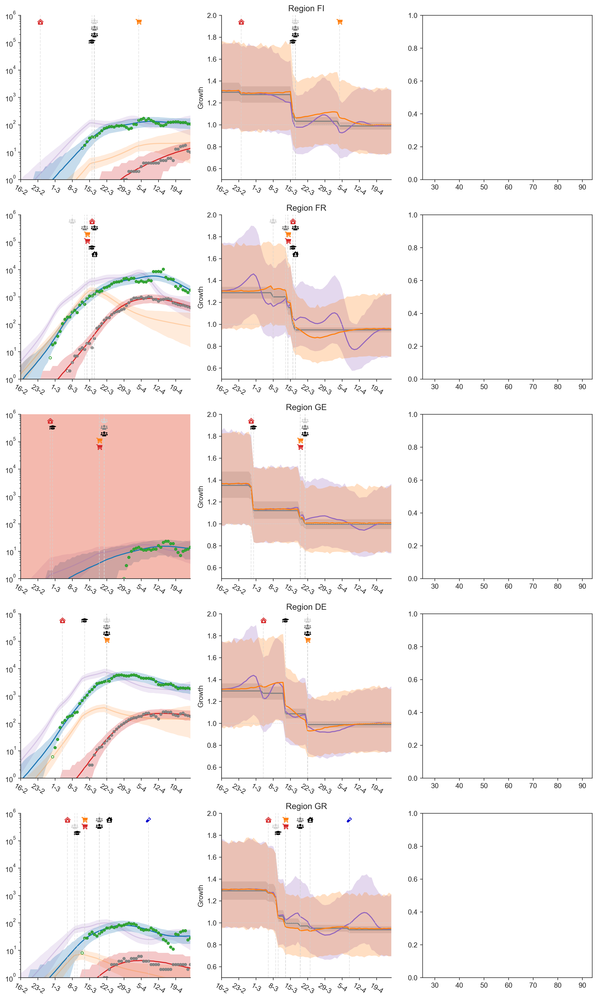

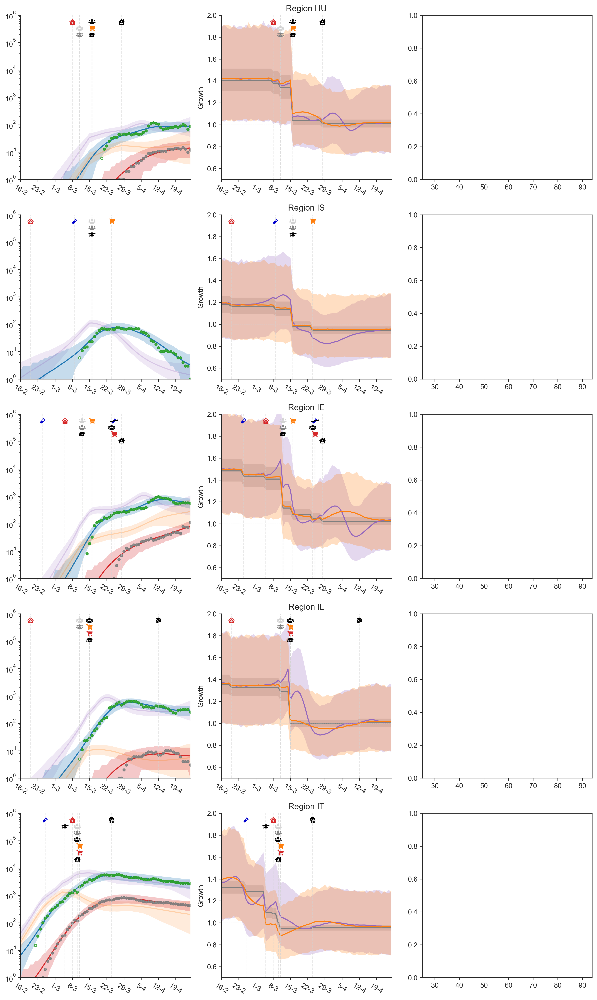

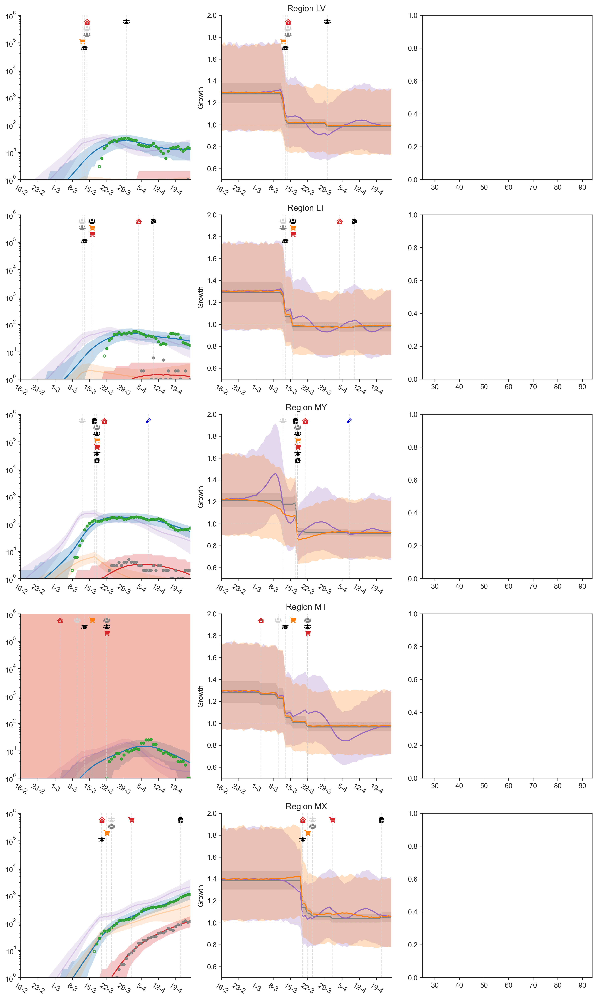

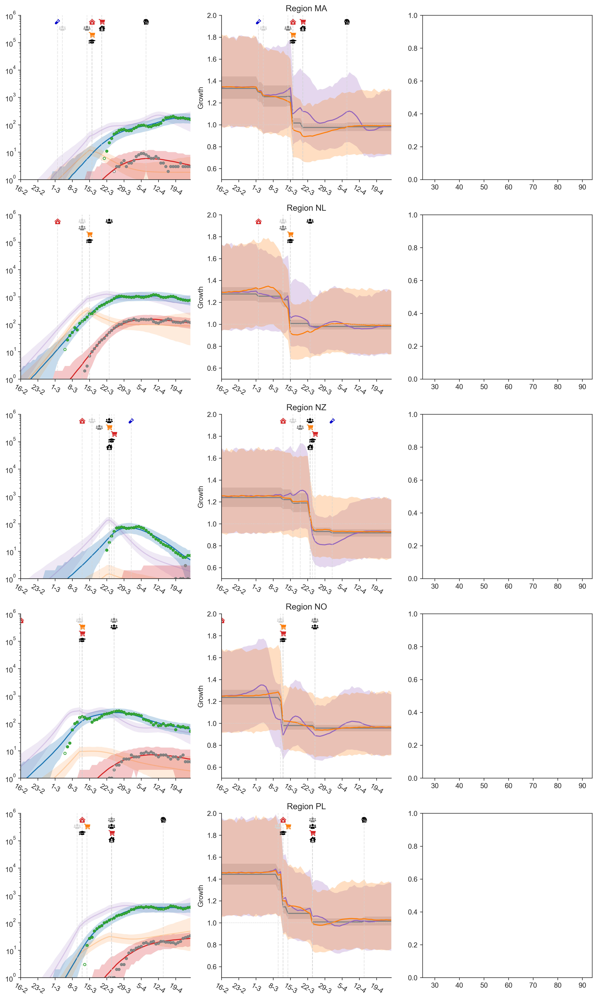

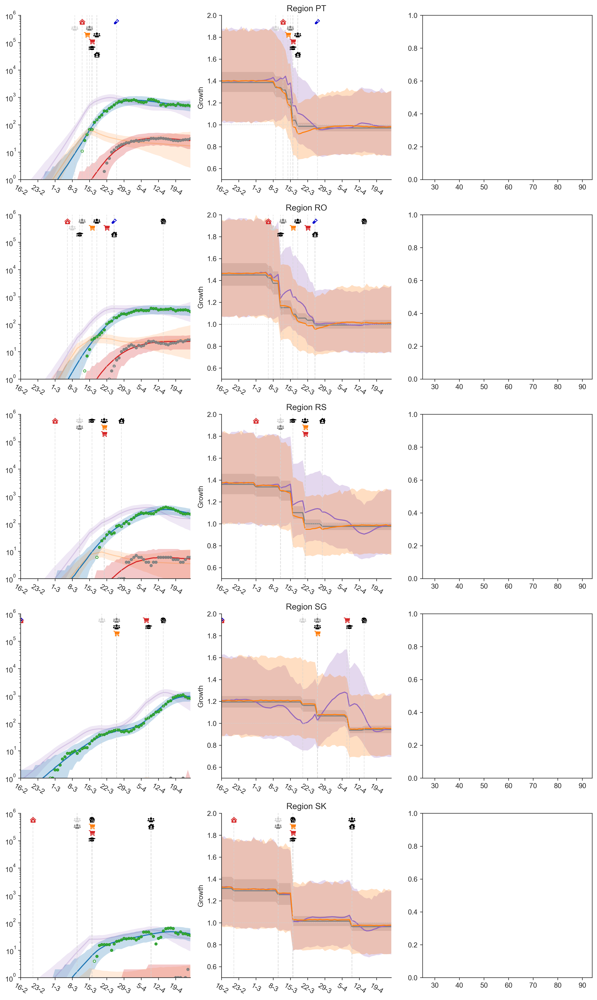

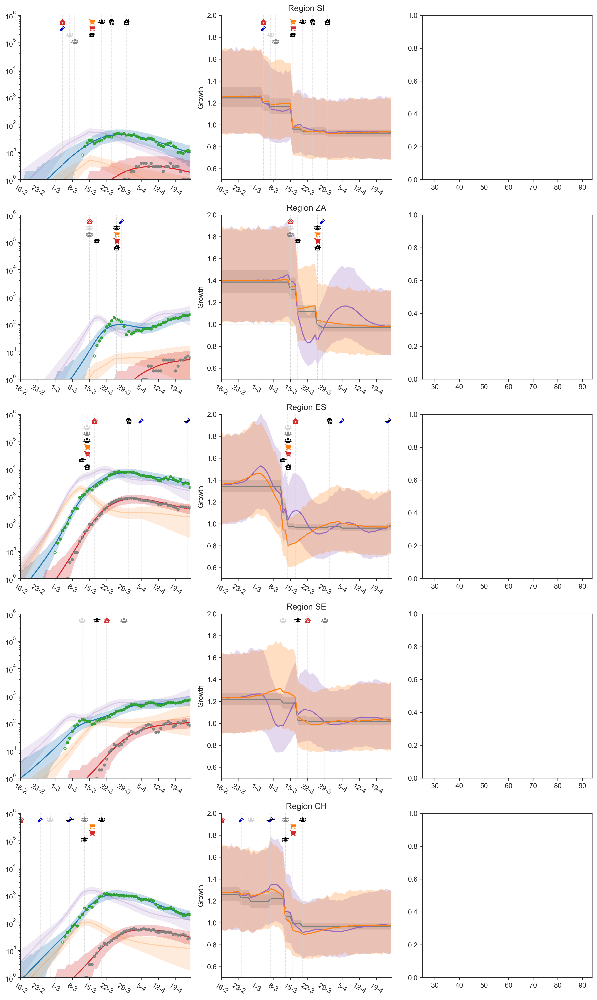

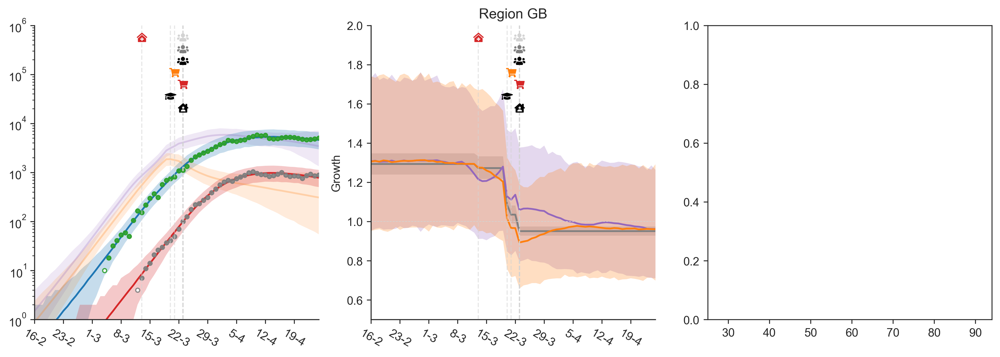

In [69]:
cm_plot_style = [
            ("\uf7f2", "tab:red"), # hospital symbol
            ("\uf963", "black"), # mask
            ("\uf492", "mediumblue"), # vial
            ("\uf0c0", "lightgrey"), # ppl
            ("\uf0c0", "grey"), # ppl
            ("\uf0c0", "black"), # ppl
            ("\uf07a", "tab:orange"), # shop 1
            ("\uf07a", "tab:red"), # shop2 
            ("\uf19d", "black"), # school
            ("\uf965", "black") # home
        ]

model.plot_region_predictions(cm_plot_style)

In [36]:
for i, cm in enumerate(model.d.CMs):
    print(f"CM: {cm} mean: {np.mean(model.trace['CMReduction'][:, i]):.3f} [{np.percentile(model.trace['CMReduction'][:, i], 2.5):.3f}, {np.percentile(model.trace['CMReduction'][:, i], 97.5):.3f}]")

CM: Healthcare Infection Control mean: 1.147 [0.973, 1.349]
CM: Mask Wearing mean: 0.908 [0.735, 1.122]
CM: Symptomatic Testing mean: 0.904 [0.772, 1.052]
CM: Gatherings <1000 mean: 0.991 [0.800, 1.214]
CM: Gatherings <100 mean: 0.954 [0.758, 1.191]
CM: Gatherings <10 mean: 0.761 [0.627, 0.916]
CM: Some Businesses Suspended mean: 0.666 [0.528, 0.838]
CM: Most Businesses Suspended mean: 0.831 [0.694, 0.991]
CM: School Closure mean: 0.667 [0.524, 0.839]
CM: Stay Home Order mean: 0.824 [0.685, 0.980]


In [46]:
model.vars

[CM_Alpha,
 HyperRMean,
 HyperRVar_log__,
 RegionLogROffset,
 GrowthCases,
 GrowthDeaths,
 InitialSizeCases_log,
 InitialSizeDeaths_log]

array([[<matplotlib.axes._subplots.AxesSubplot object at 0x1bb3f79d0>,
      dtype=object)

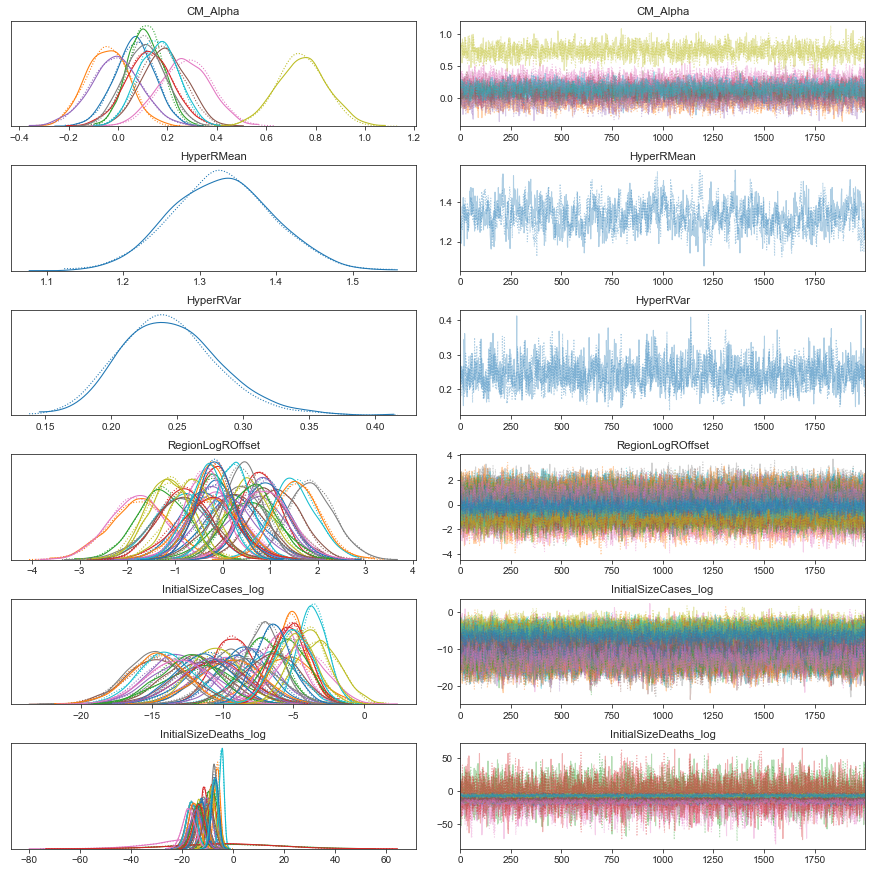

In [70]:
v = ['CM_Alpha',
 'HyperRMean',
 'HyperRVar',
 'RegionLogROffset',
 #'GrowthCases',
 #'GrowthDeaths',
 'InitialSizeCases_log',
 'InitialSizeDeaths_log']
pm.traceplot(model.trace, var_names=v)

In [15]:
pm.traceplot?

In [19]:
model.profile(model.logpt).summary()

Function profiling
  Message: /Users/jsalvatier/Library/Caches/pypoetry/virtualenvs/epimodel-Y5DpXmSQ-py3.8/lib/python3.8/site-packages/pymc3/model.py:1019
  Time in 1000 calls to Function.__call__: 8.220108e-01s
  Time in Function.fn.__call__: 7.699802e-01s (93.670%)
  Time in thunks: 7.250037e-01s (88.199%)
  Total compile time: 9.805241e-01s
    Number of Apply nodes: 83
    Theano Optimizer time: 8.332162e-01s
       Theano validate time: 1.311636e-02s
    Theano Linker time (includes C, CUDA code generation/compiling): 5.760908e-02s
       Import time 0.000000e+00s
       Node make_thunk time 5.369496e-02s
           Node Elemwise{Mul}[(0, 1)](InplaceDimShuffle{x,0,x}.0, AdvancedSubtensor1.0) time 1.693010e-03s
           Node Elemwise{Composite{Switch(i0, Switch((EQ(i1, i2) * i3), i2, Switch(Cast{int8}(GE(i1, i2)), ((Switch(EQ(i1, i2), i4, (i5 * log(i1))) - i6) - i1), i7)), Switch(Cast{int8}(GT(i1, i2)), (i8 + Switch(EQ((i1 / (i9 + i1)), i2), i4, (i5 * log((i1 / (i9 + i1))))) + S

In [21]:
model.profile(pm.gradient(model.logpt, model.vars)).summary()

Function profiling
  Message: /Users/jsalvatier/Library/Caches/pypoetry/virtualenvs/epimodel-Y5DpXmSQ-py3.8/lib/python3.8/site-packages/pymc3/model.py:1019
  Time in 1000 calls to Function.__call__: 1.471125e+00s
  Time in Function.fn.__call__: 1.405699e+00s (95.553%)
  Time in thunks: 1.313805e+00s (89.306%)
  Total compile time: 1.220310e+01s
    Number of Apply nodes: 140
    Theano Optimizer time: 2.065000e+00s
       Theano validate time: 4.491377e-02s
    Theano Linker time (includes C, CUDA code generation/compiling): 9.999947e+00s
       Import time 1.508889e-01s
       Node make_thunk time 9.991293e+00s
           Node Elemwise{Composite{((i0 * i1) // maximum((-(i2 * i3 * i4 * i5)), i6))}}[(0, 1)](TensorConstant{41}, Shape_i{1}.0, Subtensor{int64}.0, Subtensor{int64}.0, Subtensor{int64}.0, Subtensor{int64}.0, TensorConstant{1}) time 1.744417e+00s
           Node Elemwise{sub,no_inplace}(InplaceDimShuffle{0,x,1}.0, InplaceDimShuffle{0,x,1}.0) time 1.106311e+00s
           Node 

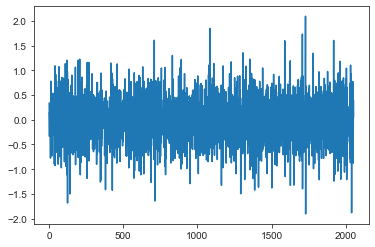

In [33]:
plt.plot(model.trace['energy_error'])

In [28]:
model.trace.stat_names

{'depth',
 'diverging',
 'energy',
 'energy_error',
 'max_energy_error',
 'mean_tree_accept',
 'model_logp',
 'step_size',
 'step_size_bar',
 'tree_size',
 'tune'}

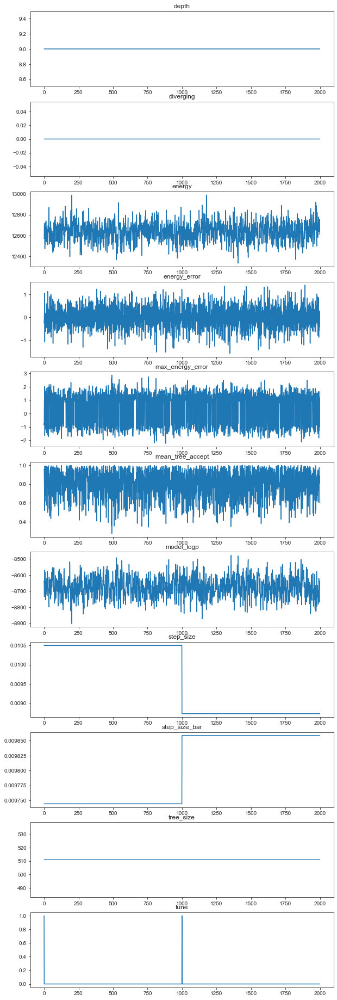

In [63]:
v =['depth',
 'diverging',
 'energy',
 'energy_error',
 'max_energy_error',
 'mean_tree_accept',
 'model_logp',
 'step_size',
 'step_size_bar',
 'tree_size',
 'tune']

def plot_stats(trace, var_names):
    n = len(var_names)
    plt.figure(figsize=(10, n *3))
    
    for i, name in enumerate(var_names): 
        plt.subplot(n, 1, i+1)
        plt.title(name)
        plt.plot(trace[name])
        
plot_stats(model.trace, v)

In [49]:
model.trace.point(-1)

{'CM_Alpha': array([ 0.07873677, -0.07002369,  0.07316996,  0.09630042,  0.15717862,
         0.09207596,  0.37053826,  0.033372  ,  0.61669579,  0.19968538]),
 'HyperRMean': 1.3412928644621136,
 'HyperRVar_log__': -1.3836748913864645,
 'RegionLogROffset': array([-0.1278548 , -1.99916203, -0.17015482,  0.53035523,  0.94987634,
         0.61067348, -0.41877284,  0.91396499, -1.66488159, -0.95415697,
        -0.37936887, -0.36044098,  0.2911981 ,  0.16515763,  0.29441218,
         1.87905727, -2.10765532,  1.1813272 ,  0.62709927,  0.45578784,
         0.71079831, -0.164422  , -1.31898093, -0.80983695,  1.11528798,
        -0.53381109,  0.16159478, -0.53756303, -0.63416166,  0.94785406,
         0.94410165,  2.01469758,  0.91228262, -0.40418737,  0.22441139,
        -1.18842184,  0.33145633,  0.31880693, -1.16893671, -0.46143447,
        -0.07432699]),
 'GrowthCases': array([[ 5.89356431e-01,  2.97118545e-01,  4.10890233e-01, ...,
         -1.67604671e-01, -3.30369688e-02,  2.77546309e-0

In [57]:
model.flatten()

FlatView(input=flat_view, replacements={CM_Alpha: Reshape{1}.0, HyperRMean: Reshape{0}.0, HyperRVar_log__: Reshape{0}.0, RegionLogROffset: Reshape{1}.0, GrowthCases: Reshape{2}.0, GrowthDeaths: Reshape{2}.0, InitialSizeCases_log: Reshape{1}.0, InitialSizeDeaths_log: Reshape{1}.0}, view={'CM_Alpha': VarMap(var='CM_Alpha', slc=slice(0, 10, None), shp=(10,), dtyp='float64'), 'HyperRMean': VarMap(var='HyperRMean', slc=slice(10, 11, None), shp=(), dtyp='float64'), 'HyperRVar_log__': VarMap(var='HyperRVar_log__', slc=slice(11, 12, None), shp=(), dtyp='float64'), 'RegionLogROffset': VarMap(var='RegionLogROffset', slc=slice(12, 53, None), shp=(41,), dtyp='float64'), 'GrowthCases': VarMap(var='GrowthCases', slc=slice(53, 3948, None), shp=(41, 95), dtyp='float64'), 'GrowthDeaths': VarMap(var='GrowthDeaths', slc=slice(3948, 7843, None), shp=(41, 95), dtyp='float64'), 'InitialSizeCases_log': VarMap(var='InitialSizeCases_log', slc=slice(7843, 7884, None), shp=(41,), dtyp='float64'), 'InitialSizeDea